# Homework 04

### Brown University  
### DATA 1010  
### Fall 2020

In [1]:
using Pkg; Pkg.activate(".")

 Activating environment at `~/problem-sets/homework/hw04/Project.toml`


## Problem 1

For the function $f(x) = x^2$, apply gradient descent with the starting point $x_0 = 4$. 

(a) For which learning rate would the second step having length zero? For which learning rate would the *third* step be the first length-zero step?

(b) For which learning rates does the sequence of iterates never visit the ray $\{x \in \mathbb{R} \,:\, x < 0\}$?

(c) For which learning rates does the sequence of iterates diverge to $\pm\infty$?

In [3]:
#(a)
using SymPy
using LinearAlgebra
using ForwardDiff: gradient

function graddescent(f, x₀, ϵ, threshold)
    step = 0
    x = x₀
    df(x) = gradient(x->f(x[1]),[x])[1]
    while norm(df(x)) > threshold
        step += 1
        x = x - ϵ*df(x)
    end
    x, step
end

f(x)=x^2
x₀=4
graddescent(f, x₀, 0.49999999, 1e-12)

(1.600000000510034e-15, 2)

In [ ]:
graddescent(f, x₀, 0.499999, 1e-12)

In [ ]:
#(b)
[(graddescent(f, x₀, ϵ, 1e-12), ϵ) for ϵ in 0.1:0.1:0.9]

In [ ]:
#(c)
graddescent(f, x₀, 1, 1e-12)

## Problem 2

Define function $f, \mathbb{R}^3 \rightarrow \mathbb{R}^1$ as:
$$
f(x, y) = \sin(x) + \sin(y) + \frac{x^2 + y^2}{10}
$$

(a) Use the code below to graph $f$. How many local minima do you see? Just from looking at the plot, where is the global minima (just a very rough estimate)?

<center><img src="surface-plot.png" width="300"></img></center>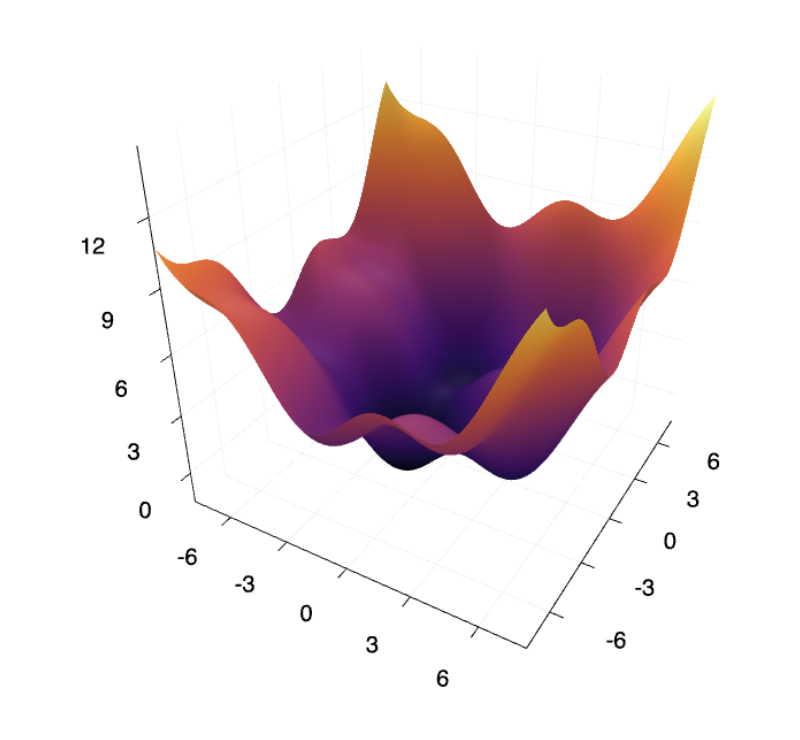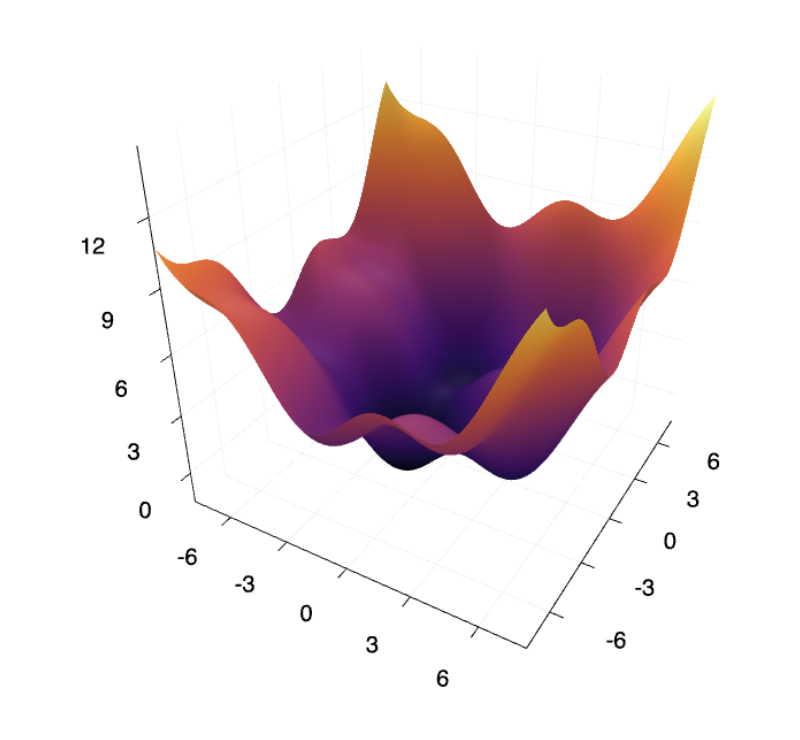

In [ ]:
using Plots
plotlyjs()
f(x,y) = sin(x) + sin(y) + (x^2 + y^2)/10
surface(-8:0.05:8, -8:0.05:8, f)

(b) Implement a vanilla gradient descent method with a tunable learning rate $\epsilon$. Run that method on this surface with multiple starting points as well as learning rates. Plot the trajectories of your gradient descent on the surface. Do all of your trajectories end up in the global minima?

Here's some code showing how to add paths and points to the plot (the actual points having nothing to do with the problem). 

In [ ]:
using Plots
plotlyjs(legend = false)
f(x,y) = sin(x) + sin(y) + (x^2 + y^2)/10
surface(-8:0.05:8, -8:0.05:8, f)
points = [(0, 0, 5), (0, 0, 10), (1, 1, 12)];
path3d!(points, linewidth = 5)
scatter3d!(points, markersize = 2)

In [4]:
function graddescent_trajectory(f, x₀, ϵ, threshold; maxiter = 500)
    df(x) = gradient(x -> f(x[1], x[2]), x₀)
    xs = [x₀]
    point = []
    while norm(df(xs[end])) > threshold && length(xs) <= maxiter
        xs_new = (xs[end] - ϵ*df(xs[end]))
        push!(xs, xs_new)
        point_new = (xs_new[1], xs_new[2], f(xs_new[1], xs_new[2]))
        push!(point, point_new)
    end
    point
end

f(x,y) = sin(x) + sin(y) + (x^2 + y^2)/10
points_f = graddescent_trajectory(f, [5.0,6.0], 0.01, 1e-12)
points_f = Tuple.(points_f)

500-element Array{Tuple{Float64,Float64,Float64},1}:
 (4.987163378145368, 5.978398297133496, 4.798728032634523)
 (4.974326756290736, 5.956796594266992, 4.7362207424827245)
 (4.961490134436104, 5.935194891400488, 4.674148499217166)
 (4.948653512581473, 5.913593188533984, 4.6125213493377215)
 (4.935816890726841, 5.8919914856674795, 4.55134923878303)
 (4.922980268872209, 5.8703897828009755, 4.490642008442979)
 (4.910143647017577, 5.848788079934471, 4.430409389712258)
 (4.897307025162945, 5.827186377067967, 4.370661000086998)
 (4.884470403308313, 5.805584674201463, 4.311406338806542)
 (4.871633781453681, 5.783982971334959, 4.252654782542374)
 (4.85879715959905, 5.762381268468455, 4.194415581136171)
 (4.845960537744418, 5.740779565601951, 4.136697853388971)
 (4.833123915889786, 5.719177862735447, 4.079510582903382)
 ⋮
 (-1.2771080869151579, -4.563232701720336, 2.2771238857363185)
 (-1.2899447087697902, -4.58483440458684, 2.299522585584034)
 (-1.3027813306244225, -4.606436107453344, 2.321743

In [6]:
using Plots
plotlyjs(legend = false)
f(x,y) = sin(x) + sin(y) + (x^2 + y^2)/10
surface(-8:0.05:8, -8:0.05:8, f)
points = points_f;
path3d!(points, linewidth = 5)
scatter3d!(points, markersize = 2)

HTML{String}("<script>\n// Immediately-invoked-function-expression to avoid global variables.\n(function() {\n    var warning_div = document.getElementById(\"webio-warning-11967973796051374434\");\n    var hide = function () {\n        var script = document.getElementById(\"webio-setup-16450822284431265241\");\n        var parent = script && script.parentElement;\n        var grandparent = parent && parent.parentElement;\n        if (grandparent) {\n            grandparent.style.display = \"none\";\n        }\n        warning_div.style.display = \"none\";\n    };\n    if (typeof Jupyter !== \"undefined\") {\n        console.log(\"WebIO detected Jupyter notebook environment.\");\n        // Jupyter notebook.\n        var extensions = (\n            Jupyter\n            && Jupyter.notebook.config.data\n            && Jupyter.notebook.config.data.load_extensions\n        );\n        if (extensions && extensions[\"webio-jupyter-notebook\"]) {\n            // Extension already loaded.\n            console.log(\"Jupyter WebIO nbextension detected; not loading ad-hoc.\");\n            hide();\n            return;\n        }\n    } else if (window.location.pathname.includes(\"/lab\")) {\n        // Guessing JupyterLa\n        console.log(\"Jupyter Lab detected; make sure the @webio/jupyter-lab-provider labextension is installed.\");\n        hide();\n        return;\n    }\n})();\n\n</script>\n<p\n    id=\"webio-warning-11967973796051374434\"\n    class=\"output_text output_stderr\"\n    style=\"padding: 1em; font-weight: bold;\"\n>\n    Unable to load WebIO. Please make sure WebIO works for your Jupyter client.\n    For troubleshooting, please see <a href=\"https://juliagizmos.github.io/WebIO.jl/latest/providers/ijulia/\">\n    the WebIO/IJulia documentation</a>.\n    <!-- TODO: link to installation docs. -->\n</p>\n")

┌ Warning: ORCA.jl has been deprecated and all savefig functionality
│ has been implemented directly in PlotlyBase itself.
│ 
│ By implementing in PlotlyBase.jl, the savefig routines are automatically
│ available to PlotlyJS.jl also.
└ @ ORCA /Users/siyushen/.julia/packages/ORCA/U5XaN/src/ORCA.jl:8


<!DOCTYPE html>
 
 
 Plots.jl

(c) Make a two-dimensional plot which colors each point according to which local minimum the gradient descent algorithm started at that point settles in. Try doing this for a few different learning rates, and comment on any interesting observations you make. 

*Hint: You don't have to do this entirely from scratch; it's done for a different function (though just for a single learning rate) in the Day-8 pre-class video.*

In [7]:
f(x,y) = sin(x) + sin(y) + (x^2 + y^2)/10
heatmap(-2:0.01:2, -2:0.01:2, f);
scatter!(Tuple.(graddescent_trajectory(f, [1.2,-0.1], 0.25, 1e-12)), label = "trajectory", color="green", msw = 0, ms = 2)

<!DOCTYPE html>
 
 
 Plots.jl

(d) Starting from a point pretty close to the global minimum, apply Newton's method (which we discussed in class), replacing $-\epsilon I$ in the gradient descent formula with $-H^{-1}$. Investigate whether this method converges faster. 

You can compute the Hessian either using automatic differentiation or symbolically, as you prefer.

In [ ]:
hessian(f, [0, -1])

In [ ]:

using JuMP, Ipopt

A = [1 2; 2 5; 4 5]
model = Model(with_optimizer(Ipopt.Optimizer, print_level=0))
@variable(model, m)
@variable(model, b)
@constraint(model, m^2 + b^2 ≤ 4)
@objective(model, Min, sum([(y - m*x - b)^2 for (x,y) in eachrow(A)]))
optimize!(model)
m2, b2 = JuMP.value(m), JuMP.value(b)





## Problem 3

Consider a 100-person queue at a theatre, with each person in the queue having their own designated seat in a theatre which has 5 rows and 25 seats per row (so there will be 25 empty seats).

(a) If all of them were to be seated randomly (each choice being made uniformly at random from the empty seats, independently from previous choices), what is the expected number of people who end up in their designated seats?

(b) Initially, there are $17, 19, 21, 23, 20$ seats assigned in each row, respectively. If every person were to be seated randomly, what is the expected number of people who end up in their originally designated row?

(c) The first person to enter lost his seat number and decides to choose their seat randomly. Every other person who enters follows the rules below:

- If their designated seat is not already taken, they will take that seat.
- If their designated seat is already taken, they will choose a seat randomly.

Use Julia to sample 100,000 instances of this experiment and thereby approximate (i) the probability that the last person in line will end up in his/her own seat, and (ii) the number of people who end up in their own seat. 

It might also be interesting to look at the some sample plots of the number of people who get to take their own seat by the time the $n$th person sits, as a function of $n$ (this part is optional). 

(a)
Since each person chooses empty seats uniformly at random and independently from previous seats, every person has $\frac{1}{125}$ to choose the right seat, since there are 100 people, the expected value will be:
$100*\frac{1}{125}$

(b) Since there are 125 seats in the originally designated row, so for each row, the probability will be $\frac{17}{125},\frac{19}{125},\frac{21}{125},\frac{23}{125},\frac{20}{125}$. Therefore, the expectation will be:
$17*\frac{17}{125}+19*\frac{19}{125}+21*\frac{21}{125}+23*\frac{23}{125}+20*\frac{20}{125} = 16.16$


In [ ]:
function choose_seat(seat_record, n)
    if n == 1
        seat_index = rand(1:125)
        return seat_index
    end
    if seat_record[n] != 0
        return n
    else
        existing_seat = [i for i = 1:length(seat_record) if seat_record[i] == 0]
        seat_index = rand(existing_seat)
        return seat_index
    end
end

function assign_all(seat_record, n=100)
    for i = 1:n
        seat_record[choose_seat(seat_record, i)] = i
    end
    return seat_record
end
function proportion(seat_record, n=1000000)
    p1=[]
    p2=[]
    for i = 1:n
        seat_record = [0 for i =1:125]
        record = assign_all(seat_record)
        push!(p1, record[100] == 100)
        push!(p2, sum(record[j]==j for j=1:100))
    end
    rst1=sum(p1)/n
    rst2=sum(p2)/n
    return rst1, rst2
end

    

In [ ]:
proportion(seat_record)

## Problem 4

Suppose we sample two independent random variables, $X_1$ and $X_2$, from the uniform distribution $\mathrm{Uniform}(0, 1)$.

(a) Explain briefly why this method is equivalent to uniformly sampling a point from the unit square $\{(a, b)\ |\ 0 \leq a \leq 1, 0 \leq b \leq 1\}$, and assigning $a$ to $x_1$ and $b$ to $x_2$. You will need to use mathematical expressions where necessary.

(b) What is the expected value and variance of $|X_1 - X_2|$?

(c) Let $Y_1 = \min(X_1, X_2)$ and $Y_1 = \max(X_1, X_2)$. What is the expected value of $Y_1$. What's the expected value of $Y_2$ What is the difference between these two expected values?

(d) Suppose we are now sampling **three** independent numbers from $\mathrm{Uniform}(0, 1)$. What is the expected value of the smallest number of the three? As an optional addition, generalize your reasoning from 3 to an arbitrary positive integer $n$. 

(a)
The probability of getting x assign to X1 and y assigned to X2 from unit square is $P(X_1<=x,X_2<=y)=(x-0)*(y-0)$, $P(X_1<=x)$ on uniform distribution is (x-0)/(1-0) and $P(X_2<=x)$ on uniform distribution is (y-0)/(1-0). Since x and y are independent, so their joint distribution is the product of $P(X_1<=x)$ and $P(X_2<=x)$, which is same as $(x-0)*(y-0)$. Therefore, they are equivalent.

In [ ]:
using Pkg
Pkg.add("Expectations")
Pkg.add("Distributions")

In [ ]:
#(b)
using Expectations, Distributions
X_1 = Uniform(0, 1)
X_2 = Uniform(0, 1)


In [ ]:
?expectation()


## Problem 5

Consider a random independent sequence of letters, with each letter uniformly distributed in {a, b, . . . , z}. Use simulation to estimate the expected number of letters that appear in the sequence up to the first appearance of aa. Repeat with ab in place of aa. Based on your findings, is the expected time to the first aa different from the expected time to the first ab?

In [ ]:
function rand_letters_till(word::AbstractString)
    letters = String([rand(collect('a':'z')) for i=1:length(word)])
    ctr = length(word)
    while letters[end-length(word)+1:end] != word
        letters = letters[2:end] * rand(collect('a':'z'))
        ctr += 1
    end
    ctr
end
mean(rand_letters_till("aa") for i=1:10^5) # returns ~700
mean(rand_letters_till("ab") for i=1:10^5) # returns ~680

In [ ]:
letters = ["a"+i for i=0:25]
function simulation(letter, signal)
    history = []
    push!(history, rand(letters))
    push!(history, rand(letters))
    cnt = 2
    while history[end-1:end] != signal
        letter = rand(letters)
        push!(history, letter)
        cnt += 1
    end
    return cnt
end

function proportion(n=10000)
    aa = []
    ab = []
    for i in 1:n
        push!(aa, simulation(letters, ['a','a']))
        push!(ab, simulation(letters, ['a','b']))
    end
    return aa, ab
end
        
    